# Figure 2 - characterisation of network and embedding

In [4]:
libraries <- c("data.table", "tidyr", "ggplot2","purrr", "grid","ggrepel", "ggExtra",
               "ggplotify","magrittr", "ggthemes", "dplyr", "igraph", "RColorBrewer", "gridExtra", "grid")
suppressWarnings(lapply(libraries, require, character.only = TRUE))
options(repr.plot.width=3, repr.plot.height=3)
options(jupyter.plot_mimetypes = "image/svg+xml") 

[[1]]
[1] TRUE

[[2]]
[1] TRUE

[[3]]
[1] TRUE

[[4]]
[1] TRUE

[[5]]
[1] TRUE

[[6]]
[1] TRUE

[[7]]
[1] TRUE

[[8]]
[1] TRUE

[[9]]
[1] TRUE

[[10]]
[1] TRUE

[[11]]
[1] TRUE

[[12]]
[1] TRUE

[[13]]
[1] TRUE

[[14]]
[1] TRUE

[[15]]
[1] TRUE

In [2]:
node_name <- fread( file="../../../data/lookup/node_name_mapping.txt")
colors <- fread( file="../../../data/lookup/color_code.txt")
node_anno <-  fread( file="../../../data/lookup/node_anno.txt")
pca_data_sub <- fread("../../../data/PCA/pca.txt")
pca_sub_dt2 <- merge(pca_data_sub, node_anno, by.x="V1", by.y="name", all.x=T)


col <- as.character(colors$node_colors)
names(col) <- as.character(colors$node_types)

In [3]:
cova <- c(paste0("InferredCov", 1:60), paste0("PC", 1:5), "pcr", "platform","RACE_1", "RACE_2", "RACE_3", paste0("DTHHRDY_", 1:4), "COHORT_1", "COHORT_2", "COHORT_3")

## read network

In [5]:
inputdir="../../../data/network"
network <- fread(file=paste0(inputdir, "/network_07_m.tsv"))

inputdir="../../../data/network"
net_raw <- fread(file=paste0(inputdir, "/full_network_filter.csv"))[,.(target, predictor, relation, mean_rsq)][predictor%in%cova]
cova_dt <- net_raw[sample(1:nrow(net_raw), 0.3*nrow(net_raw))][,relation:="expr_cova"]

network <- rbind(network, cova_dt)
actors<-unique(c(network$predictor,network$target))

relations <- data.frame(from=network$predictor,
                        to=network$target) 

# network
graph <- graph_from_data_frame(relations, directed=FALSE, vertices=actors)
graph <- as.undirected(graph)
graph <- simplify(graph)
# depth of network
diameter(graph)

[1] 6

## nodes plot

In [6]:
unique(network$relation)
genes <- unique(c(network$target, network[relation=="prior_expr", predictor]))
pheno <- c("SEX", "AGE", "BMI")
cova <- c(paste0("InferredCov", 1:60), paste0("PC", 1:5), "pcr", "platform","RACE_1", "RACE_2", "RACE_3", paste0("DTHHRDY_", 1:4), "COHORT_1", "COHORT_2", "COHORT_3")
como <- network[relation=="como_expr", predictor] %>% unique
prs <- network[relation=="prs_expr", predictor] %>% unique
pred <- network$predictor %>% unique
tissue <- pred[grep("SMTSD_",pred)]


nodes <- list(gene=genes,
              pheno=pheno,
              como=como,
              prs=prs,
              cova=cova,
              tissue=tissue)

[1] "como_expr"  "prs_expr"   "bio_expr"   "tiss_expr"  "prior_expr"
[6] "expr_cova"

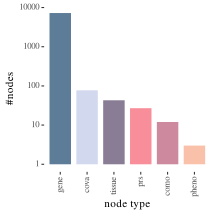

In [7]:
plt_dt <- suppressWarnings(melt(unlist(lapply(nodes, length))) %>% setDT(keep.rownames=T) %>% .[order(-value)])
idorder_nodes <- plt_dt$rn 
plt_dt$rn <- factor(plt_dt$rn,levels=idorder_nodes)



n2 <- ggplot(plt_dt, aes(x=rn, y=(value), fill=rn)) +  geom_bar(stat = "identity", alpha=0.8, width=0.8) +
  theme_tufte() +
  scale_fill_manual(values=col) + 
  theme(legend.position = "none")+
  scale_y_continuous(trans = "log10") + 
  theme(axis.text.x = element_text(angle = 90,hjust = 1, vjust=0.5))+
  #scale_y_continuous(breaks = function(x) unique(floor(pretty(seq(0, (max(x) + 1) * 1.1)))))+
  labs(y="#nodes", x="node type");n2

In [8]:
plt_dt

rn,value
gene,7207
cova,77
tissue,43
prs,27
como,12
pheno,3


## edge plot

gene     pheno      como       prs      cova    tissue    gene_1    gene_2 
"#355C7D" "#F8B195" "#C06C84" "#F67280" "#C7CEEA" "#6C5B7B" "#355C7D" "#477aa6" 
   gene_3    gene_4 
"#6997bf" "#92b4d1"

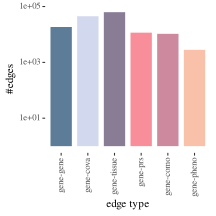

In [16]:
network[predictor%in%pheno, edge:="gene-pheno"]
network[predictor%in%cova, edge:="gene-cova"]
network[predictor%in%como, edge:="gene-como"]
network[predictor%in%prs, edge:="gene-prs"]
network[predictor%in%genes, edge:="gene-gene"]
network[predictor%in%tissue, edge:="gene-tissue"]

plt_dt <- network[,.N, by=edge][order(-N)]
idorder <- c("gene-gene", "gene-cova","gene-tissue", "gene-prs","gene-como","gene-pheno")

# colors
col_edge <- as.character(colors$node_colors)
names(col_edge) <- paste0("gene-",colors$node_types)
col
# order
plt_dt$edge <- factor(plt_dt$edge,levels=idorder)
e1 <- ggplot(plt_dt, aes(x=edge, y=(N), fill=edge)) +  geom_bar(stat = "identity", alpha=0.8, width=0.8) +
  theme_tufte() +
  scale_fill_manual(values=col_edge) + 
  theme(legend.position = "none")+
  scale_y_continuous(trans = "log10") + 
  theme(axis.text.x = element_text(angle = 90,hjust = 1, vjust=0.5))+
  labs(y="#edges", x="edge type");e1

In [8]:
plt_dt

edge,N
gene-tissue,62902
gene-cova,44965
gene-gene,18521
gene-prs,11613
gene-como,10553
gene-pheno,2817


## R2

[1] 0.4436114

[1] 0.5164006

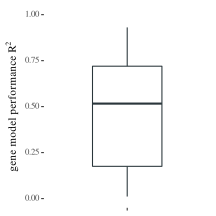

In [17]:
plt_dt <- network[!relation=="expr_cova"][,. (target, mean_rsq)] %>% unique
mean(plt_dt$mean_rsq)
median(plt_dt$mean_rsq)

plt_dt[,type:="R2"]
r2 <- ggplot(plt_dt, aes(y=mean_rsq, x=type)) + 
  geom_boxplot(color="#2A363B", alpha=0.5, width=0.5) +
  labs(y=expression(gene~model~performance~R^{2}),
       x="") +
  ylim(c(0,1))+
  theme_tufte()+
  theme(axis.title.x = element_blank(),
        axis.text.x = element_blank());r2

## plotting network

In [10]:
btw_net <- fread(file="/../../../data/network/btw_net_network07.txt")

In [11]:
plot_network <- function(subnet, threshold=F){
  subnet <- data.frame(lapply(subnet, as.character), stringsAsFactors=FALSE)
  # subnet$target <- gsub("_", ".", subnet$target)
  # subnet$predictor <- gsub("_", ".", subnet$predictor)
  subnet$edge <- gsub("gene-","", subnet$edge)
  
  label <- unique(c(paste0("gene:",subnet[,1]),paste0(subnet$edge,":",subnet[,2])))
  
  actors <- data.frame(name=do.call(rbind, strsplit(label,":") )[,2],
                       omic= do.call(rbind, strsplit(label,":") )[,1]
  )

  
  relations <- data.frame(from=subnet$predictor,
                          to=subnet$target) 
  
  actors <- unique(actors) %>%  setDT
  g <- graph_from_data_frame(relations, directed=FALSE, vertices=actors)
  graph <- as.undirected(g)
  graph <- simplify(g)
  deg2 <- igraph::degree(g, mode="all")
  
  # plot(g, vertex.label.color="black", vertex.size=10, vertex.label=NA , vertex.label.dist=1.5)
  # library(qgraph)
  
  e <- get.edgelist(g,names=FALSE)
  # l <- qgraph.layout.fruchtermanreingold(e,vcount=vcount(g),  area=1000*(vcount(g)^2),repulse.rad=100+(vcount(g)^30))
  
  library(RColorBrewer)
  
  actors[, edges:=igraph::degree(g)]
  actors[, mynames:=name]
  
  
  actors$id <- 1:nrow(actors)
  actors <-actors[order(id)]
  summary(actors$edges)
  
  if(threshold==T){
    edge_threshold <- (as.numeric(sub('.*:', '', summary(actors$edges)[5])) +as.numeric(sub('.*:', '', summary(actors$edges)[6])))/2
  }else{
    edge_threshold<-12000
  }
  
  
  actors[edges>edge_threshold,]
  actors[,.N, by=edges,][order(edges)]
  actors[edges < edge_threshold  , mynames:=NA]
  # colors[node_types=="gene", node_colors:="#6997bf"]
  actors <- merge(actors, colors, by.x="omic", by.y="node_types") 
  actors <- actors[order(id)]
  plt <- plot(g,
    # layout=layout_nicely(g, dim = 2),
     layout=layout.fruchterman.reingold(g),
     vertex.frame.color= adjustcolor("black", .01)	, 
     vertex.size=3,
     vertex.color=actors$node_colors ,
     edge.color =  adjustcolor("grey", .8),
     edge.curved=0,
     vertex.label = actors$mynames,
     vertex.label.color= adjustcolor("black", .8),
     vertex.label.cex = 0.7,    asp = 1 ,
     edge.width=E(g)$weight*400)
  return(plt)

}

In [12]:
priorit_btw <-function(x){
  return(merge(network[predictor%in%x], btw_net, by.x="target", by.y="node")[order(-betweenness)][1:500])
  # return(merge(network[predictor%in%x], btw_net, by.x="target", by.y="node"))

}
priorit_btw2 <-function(x){
  dt <- merge(network[target%in%x], btw_net, by.x="predictor", by.y="node")
  dt2 <- dt[order( -abs(betweenness))][1:1]
  return(dt2)
}


mynet <- rbind(
  priorit_btw('covid19hg'),
  priorit_btw('covid19hghospitalized'),
  priorit_btw('diabetesType2'),
  priorit_btw('SMTSD_Brain_Frontal_Cortex_BA9'),
  priorit_btw('MHPNMNIA'),
  priorit_btw('MHCOPD'),


  priorit_btw('diabetesType1'),
  #do.call(rbind,map(t_vec,priorit_btw2)),
  priorit_btw('cancer'),
  priorit_btw('BIP'),
  priorit_btw('SCZ'),

  priorit_btw('MDD'),
  priorit_btw('obesity'),

  priorit_btw('covid19hgsevere')

)

mynet <- na.omit(mynet)
dt <- mynet[,.N, by=target][order(-N)]
t_vec <- dt[N>2, target]
mynet <- rbind(
  priorit_btw('covid19hg'),
  priorit_btw('covid19hghospitalized'),
  priorit_btw('diabetesType2'),
  priorit_btw('SMTSD_Brain_Frontal_Cortex_BA9'),
  priorit_btw('MHPNMNIA'),
  priorit_btw('MHCOPD'),


  priorit_btw('diabetesType1'),
  do.call(rbind,map(t_vec,priorit_btw2)),
  priorit_btw('cancer'),
  priorit_btw('BIP'),
  priorit_btw('SCZ'),

  priorit_btw('MDD'),
  priorit_btw('obesity'),

  priorit_btw('covid19hgsevere')

)


In [13]:
rel_dt <- as.data.table(relations)


In [41]:
  subnet <- data.frame(lapply(mynet, as.character), stringsAsFactors=FALSE)
  # subnet$target <- gsub("_", ".", subnet$target)
  # subnet$predictor <- gsub("_", ".", subnet$predictor)
  subnet$edge <- gsub("gene-","", subnet$edge)
  
  label <- unique(c(paste0("gene:",subnet[,1]),paste0(subnet$edge,":",subnet[,2])))
  
  actors <- data.frame(name=do.call(rbind, strsplit(label,":") )[,2],
                       omic= do.call(rbind, strsplit(label,":") )[,1]
  )
  relations <- data.frame(from=as.character(subnet$predictor),
                          to=as.character(subnet$target)) 
    actors <- unique(actors) %>%  setDT
  g <- graph_from_data_frame(relations, directed=FALSE, vertices=actors)

  

Warning message in graph_from_data_frame(relations, directed = FALSE, vertices = actors):
“In `d' `NA' elements were replaced with string "NA"”Warning message in `[<-.factor`(`*tmp*`, thisvar, value = "NA"):
“invalid factor level, NA generated”Warning message in `[<-.factor`(`*tmp*`, thisvar, value = "NA"):
“invalid factor level, NA generated”

ERROR: Error in graph_from_data_frame(relations, directed = FALSE, vertices = actors): Duplicate vertex names


In [13]:
plot_network(subnet=mynet, threshold=F)


Warning message in graph_from_data_frame(relations, directed = FALSE, vertices = actors):
“In `d' `NA' elements were replaced with string "NA"”Warning message in `[<-.factor`(`*tmp*`, thisvar, value = "NA"):
“invalid factor level, NA generated”Warning message in `[<-.factor`(`*tmp*`, thisvar, value = "NA"):
“invalid factor level, NA generated”

ERROR: Error in graph_from_data_frame(relations, directed = FALSE, vertices = actors): Duplicate vertex names


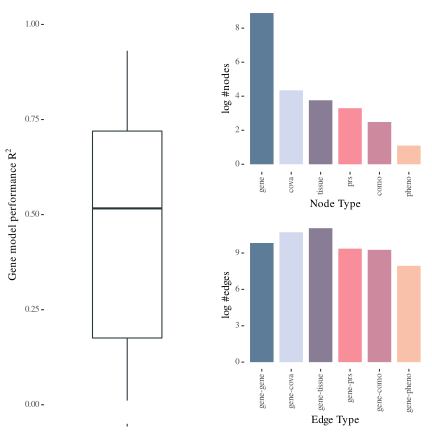

In [14]:
grid.arrange(n2,e1, r2, layout_matrix = rbind(c(3,1),
                                          c(3,2)))

## embedding std

### std and mean

In [32]:
results <- fread("../../../data/mean_sim_nodes/robust_genes.tsv")
results[,var_sim:=(sem_sim^2)]

results[mean_sim>=0.65, above:=">=0.65"]
results[is.na(above), above:="<0.65"]
plt_dt <- results[sample(nrow(results), 100000), ]
plt_dt <- results[node1=="diabetesType1"][order(-mean_sim)]
t_x <- head(plt_dt, n=250) %>% tail(.,n=1) %>% .$mean_sim

plt_dt[mean_sim>=t_x, pos:="top 500"]
plt_dt[(mean_sim<t_x), pos:="rest"]
vec <- plt_dt[,mean_sim]
m <-  (max(vec) - (min(vec)))/50
t_num <- abs(round((max(vec) - t_x)/m))



std_mean <- ggplot(plt_dt, aes(y=sem_sim, x=mean_sim, color=pos)) + 
  geom_point(  size=0.5)+
  scale_color_manual(values=c("azure2","slategray4"))+
  labs(x="Mean sim score over 100 runs", y="Sim score std over 100 runs")+
 theme_tufte()+theme(legend.position = "none")

std_mean_hist <- ggMarginal(std_mean, type="histogram",
           xparams = list(fill = c(
             rep("azure2", 49-(t_num)),
             rep("slategray4", t_num)
           ),
           color = c(
             rep("azure2", 49-(t_num)),
             rep("slategray4", t_num)
           ),
           bins=50),
           yparams = list(color="azure2", fill="azure2", bins=50));std_mean_hist

In [50]:
#unique(results[!type_node1=="genes", node1])%>% sort
results[, max(mean_sim), by=node1]

node1,V1
ADHD,0.9497464
AGE,0.9545494
BIP,0.8871201
BMI,0.9784665
MDD,0.9508256
MHASTHMA,0.9874590
MHCOPD,0.8929698
MHCVD,0.9043234
MHDPRSSN,0.9712408
MHHRTDIS,0.9043234


In [60]:
results[mean_sim>=0.65, above:=">=0.65"]
results[is.na(above), above:="<0.65"]
plt_dt <- results[sample(nrow(results), 100000), ]
plt_dt <- results[node1=="obesity"][order(-mean_sim)]

vec <- plt_dt[,mean_sim]
m <-  (max(vec) - (min(vec)))/50
t_num <- abs(round((max(vec) - 0.65)/m))



std_mean <- ggplot(plt_dt, aes(y=var_sim, x=mean_sim, color=above)) + 
  geom_point(  size=0.5)+
  scale_color_manual(values=c("azure2","slategray4"))+
  labs(x="mean(sim score) over 100 runs\n to PRS obesity node", y="var(sim score) over 100 runs")+
 theme_tufte()+theme(legend.position = "none")

std_mean_hist <- ggMarginal(std_mean, type="histogram",
           xparams = list(fill = c(
             rep("azure2", 49-(t_num)),
             rep("slategray4", t_num)
           ),
           color = c(
             rep("azure2", 49-(t_num)),
             rep("slategray4", t_num)
           ),
           bins=50),
           yparams = list(color="azure2", fill="azure2", bins=50));std_mean_hist

In [47]:
ggMarginal(std_mean, groupColour = TRUE, groupFill = TRUE)


## std over all nodes

In [51]:
std_plt_dt <- results[,.(var_sim)]
std_plt_dt[,type:="sth"]
std_plot <- ggplot(std_plt_dt, aes(y=var_sim, x=type)) + 
  # geom_violin()+ 
  geom_boxplot(color="#2A363B", width=0.5,outlier.size = 0.4) +
  labs(#y=expression(var(sim~score)~all~non~gene~nodes^{}),
      y="var(sim score) all non-gene nodes",
         # expression(Gene~model~performance~R^{2}),
       x="") +
  # ylim(c(0,1))+
  theme_tufte()+
  theme(axis.title.x = element_blank(),
        axis.text.x = element_blank());std_plot

In [ ]:
results[,rel_std:=(sem_sim/mean_sim)]
head(results)

In [ ]:
ggplot(results, aes(x=rel_std, y=mean_sim) +  geom_point()

In [70]:
resultsdir="results/fig1_network_characteristics/"
pdf(file=paste0(resultsdir, Sys.Date(), "_1ABDE.pdf"), height=6, width=4)
grid.arrange(n2,e1, r2, std_mean_hist, std_plot, layout_matrix = rbind(
                                          c(3,3,1,1),
                                          c(3,3,2,2),
                                          c(4,4,4,5),
                                          c(4,4,4,5)))
dev.off()

pdf(file=paste0(resultsdir, Sys.Date(), "_1AB.pdf"), height=3, width=4)
grid.arrange(n2,e1, r2, layout_matrix = rbind(
                                          c(3,3,1,1),
                                          c(3,3,2,2)))
dev.off()

pdf(file=paste0(resultsdir, Sys.Date(), "_1FG.pdf"), height=3, width=4)
grid.arrange(std_mean_hist, std_plot, layout_matrix = rbind(
                                         c(1,1,1,2),
                                          c(1,1,1,2)))
dev.off()

png 
  2

png 
  2

png 
  2

In [18]:
svg(file=paste0(resultsdir, Sys.Date(), "_1AB.svg"), height=3, width=4)
grid.arrange(n2,e1, r2, layout_matrix = rbind(
                                          c(3,3,1,1),
                                          c(3,3,2,2)))
dev.off()


ERROR: Error in paste0(resultsdir, Sys.Date(), "_1AB.svg"): object 'resultsdir' not found


In [71]:


svg(file=paste0(resultsdir, Sys.Date(), "_1AB.svg"), height=3, width=4)
grid.arrange(n2,e1, r2, layout_matrix = rbind(
                                          c(3,3,1,1),
                                          c(3,3,2,2)))
dev.off()

svg(file=paste0(resultsdir, Sys.Date(), "_1FG.svg"), height=3, width=4)
grid.arrange(std_mean_hist, std_plot, layout_matrix = rbind(
                                         c(1,1,1,2),
                                          c(1,1,1,2)))
dev.off()

png 
  2

png 
  2

In [61]:
grid.arrange(n2,e1, r2, std_mean_hist, std_plot, layout_matrix = rbind(
                                          c(3,3,1,1),
                                          c(3,3,2,2),
                                          c(4,4,4,5),
                                          c(4,4,4,5)))